### Start of the main Text-Processing 

For starters, let's removing all the non-ascii characters and multiple spaces. Then we can see what type of noisy words we have by using N-Grams function

In [71]:
t1 = time.time() 
df_all_news_processed = Cleaner.remove_non_ascii_chars(df_all_news_processed)
df_all_news_processed = Cleaner.remove_multiple_spaces(df_all_news_processed)
#df_all_news_processed = Cleaner.drop_null_values(df_all_news_processed)
#df_all_news_processed = Cleaner.drop_duplicate_values(df_all_news_processed)
EDA.process_time(round(time.time()-t1))

Process completed.
Time taken: 1mins 25secs


--------------------------------
### ---- SIDE: Identifying noisy words

In [26]:
%%time
########## N-GRAMS ###########
articles_split_by_word = NLP.tokenization(df_all_news_processed)
n = 4 #Specify for N-Grams
occurrences = EDA.find_most_common_n_grams(articles_split_by_word, n)

Wall time: 2min 19s


In [28]:
sorted(occurrences.items(), key=lambda x: x[1], reverse=True)[:20]

[('{* registration_firstName *} {*', 14158),
 ('our Visitor Agreement and', 5976),
 ('Published By: Reuters -', 4094),
 ('Published By: Huffington Post', 3684),
 ('Published By: Fox News:', 3320),
 ('Thank you for registering!', 3316),
 ('Published By: Charlotte Observer:', 2786),
 ('Published By: Forbes.com: Latest', 2420),
 ('Published By: Charlotte Observer', 1818),
 ('Ads with Photos only:', 1811),
 ('Published By: CBS News:', 1772),
 ('Published By: Pittsburgh Post:', 1732),
 ('Published By: Boston Herald', 1718),
 ('Published By: Denver Post', 1644),
 ('Tip : Use comma', 1439),
 ('Published By: Des Moines', 1410),
 ('Published By: ABC News:', 1314),
 ('Published By: Las Vegas', 1260),
 ('Published By: Detroit Free', 1246),
 ('{* #registrationFormBlank *} {*', 1232)]

As we can see there are a lot of noisy words that need to be removed. For this particular task we will create a separate notebook (<b>Find_noisy_words.ipynb</b>) where we will deal also with the duplicate records. To do that, we need to save the current dataframe in a pickle and use it to our other notebook. 
However, all the functions will be part of the Cleaner class in <code>remove_most_noisy_words()</code> and we will not require to load any other pickle after the removal of the noisy words.

In [6]:
#checkpoint: save the dataset as pickle
#df_all_news_processed.reset_index(drop=True, inplace=True)
df_all_news_processed.to_pickle('data/original_data/pickles/df_all_news_processed_pre_cleaning_noisy_words')
#df_all_news_processed = pd.read_pickle(r'data/original_data/pickles/df_all_news_processed_pre_cleaning_noisy_words')

--------------------------------

Remove most noisy words according to N-Grams notebook analysis (3.1_Find_noisy_words.ipynb)

In [7]:
t1 = time.time()
df_all_news_processed = Cleaner.remove_most_noisy_words(df_all_news_processed)
df_all_news_processed = Cleaner.remove_multiple_spaces(df_all_news_processed)
EDA.process_time(round(time.time()-t1))

Process completed.
Time taken: 11mins 33secs


In [8]:
t1 = time.time() 
df_all_news_processed['Text'] = NLP.to_lower_case(df_all_news_processed, 'Text')
articles_split_by_word = NLP.tokenization(df_all_news_processed)
df_all_news_processed['Text'] = articles_split_by_word.apply(NLP.remove_stop_words)
df_all_news_processed['Text'] = df_all_news_processed['Text'].apply(NLP.rejoin_words) 
#df_all_news_processed = Cleaner.remove_punctuation(df_all_news_processed)
df_all_news_processed = Cleaner.remove_single_chars(df_all_news_processed)
df_all_news_processed = Cleaner.remove_double_chars(df_all_news_processed)
df_all_news_processed = Cleaner.remove_punctuation_v2(df_all_news_processed)
df_all_news_processed = Cleaner.remove_multiple_spaces(df_all_news_processed)

EDA.process_time(round(time.time()-t1))

Process completed.
Time taken: 13mins 42secs


In [9]:
t1 = time.time()

df_all_news_processed = Cleaner.remove_links(df_all_news_processed)
df_all_news_processed = Cleaner.remove_dates(df_all_news_processed)
df_all_news_processed = Cleaner.remove_years(df_all_news_processed)
df_all_news_processed = Cleaner.remove_months(df_all_news_processed)
df_all_news_processed = Cleaner.remove_days(df_all_news_processed)
df_all_news_processed = Cleaner.remove_time(df_all_news_processed)
df_all_news_processed = Cleaner.remove_punctuation(df_all_news_processed)
#second and last iteration of the following 2 cleans
df_all_news_processed = Cleaner.remove_single_chars(df_all_news_processed)
df_all_news_processed = Cleaner.remove_punctuation_v2(df_all_news_processed)
df_all_news_processed = Cleaner.remove_multiple_spaces(df_all_news_processed)
df_all_news_processed = Cleaner.drop_duplicate_values(df_all_news_processed)#maybe this should go on top with null values

#count the new number of words per article
df_all_news_processed['Text_TotalWords'] = EDA.count_words_per_records_opt_2(df_all_news_processed)

EDA.process_time(round(time.time()-t1))

Process completed.
Time taken: 8mins 46secs


In [3]:
#checkpoint: save the dataset as pickle
#df_all_news_processed.reset_index(drop=True, inplace=True)
#df_all_news_processed.to_pickle('data/original_data/pickles/df_all_news_processed_post_cleaning')
df_all_news_processed = pd.read_pickle(r'data/original_data/pickles/df_all_news_processed_post_cleaning')

### N-Grams


In [76]:
########## N-GRAMS ###########
t1 = time.time()
articles_split_by_word = NLP.tokenization(df_all_news_processed)

n = 1 #Specify number for N-Grams
occurrences = EDA.find_most_common_n_grams(articles_split_by_word, n)
EDA.process_time(round(time.time()-t1))

Process completed.
Time taken: 5mins 27secs


In [77]:
sorted(occurrences.items(), key=lambda x: x[1], reverse=True)[:30]

[('', 37258),
 ('said', 8802),
 ('new', 3191),
 ('percent', 2636),
 ('game', 2045),
 ('police', 1665),
 ('china', 1573),
 ('news', 1572),
 ('clinton', 1548),
 ('state', 1492),
 ('yards', 1317),
 ('trump', 1233),
 ('apple', 1131),
 ('u.s.', 1128),
 ('million', 1110),
 ('odom', 1080),
 ('per', 1009),
 ('bank', 960),
 ('travel', 954),
 ('ket', 878),
 ('city', 858),
 ('obama', 826),
 ('hotel', 792),
 ('company', 781),
 ('people', 770),
 ('business', 739),
 ('oil', 738),
 ('president', 734),
 ('government', 728),
 ('cubs', 704)]

The most frequent word appears to be empty. That is weird since we stripped off every multiple space including new-line '\n'. Let's see what we've got on tri-grams

In [78]:
########## N-GRAMS ###########
t1 = time.time()
n = 3 #Specify number for N-Grams
occurrences = EDA.find_most_common_n_grams(articles_split_by_word, n)
EDA.process_time(round(time.time()-t1))
sorted(occurrences.items(), key=lambda x: x[1], reverse=True)[:30]

Process completed.
Time taken: 37 seconds


[('new york mets', 509),
 (' before news', 483),
 ('new york ap', 478),
 (' today new', 467),
 ('new york city', 457),
 ('president barack obama', 431),
 ('rugby world cup', 415),
 ('usa today sports', 402),
 (' world news', 388),
 ('kansas city royals', 348),
 (' business today', 311),
 ('toronto blue jays', 298),
 ('islamic state group', 278),
 ('journal sports today', 276),
 ('indicates required field', 275),
 ('0 0 0', 273),
 ('hillary rodham clinton', 270),
 ('daily fantasy sports', 246),
 ('updated 2 hours', 242),
 ('high school football', 240),
 (' recommended related', 234),
 ('updated 3 hours', 224),
 ('los angeles dodgers', 215),
 (' today washington', 210),
 ('facebook twitter pinterest', 205),
 ('updated 1 hour', 198),
 (' can chronicle', 196),
 ('republican presidential candidate', 194),
 (' today two', 194),
 (' today latest', 193)]

Again, we see some added space to be recognised as a word. More pecifically for example ' before news' considers to be a trigram while in reality it's a bigram

Let's remove every word that has less than 1 length and run it again.

In [77]:
t1 = time.time()
articles_split_by_word = Cleaner.remove_ghost_words(articles_split_by_word)

n = 3 #Specify number for N-Grams
occurrences = EDA.find_most_common_n_grams(articles_split_by_word, n)
EDA.process_time(round(time.time()-t1))
sorted(occurrences.items(), key=lambda x: x[1], reverse=True)[:30]

Process completed.
Time taken: 40 seconds


[('new york mets', 511),
 ('new york ap', 497),
 ('new york city', 459),
 ('president barack obama', 438),
 ('rugby world cup', 418),
 ('usa today sports', 402),
 ('world news today', 375),
 ('kansas city royals', 349),
 ('toronto blue jays', 298),
 ('islamic state group', 278),
 ('journal sports today', 276),
 ('indicates required field', 275),
 ('0 0 0', 273),
 ('hillary rodham clinton', 270),
 ('daily fantasy sports', 246),
 ('high school football', 243),
 ('updated 2 hours', 242),
 ('recommended related articles', 234),
 ('updated 3 hours', 224),
 ('los angeles dodgers', 215),
 ('facebook twitter pinterest', 205),
 ('updated 1 hour', 198),
 ('republican presidential candidate', 194),
 ('today new york', 189),
 ('salt lake city', 179),
 ('ors without borders', 176),
 ('new york times', 168),
 ('updated 4 hours', 167),
 ('umpqua community college', 165),
 ('related quotes symbol', 164)]

Now our issue seems to be solved. Let's apply the updates to the whole dataset

In [78]:
df_all_news_processed['Text'] = articles_split_by_word.apply(NLP.rejoin_words)
#count the new number of words per article
df_all_news_processed['Text_TotalWords'] = EDA.count_words_per_records_opt_2(df_all_news_processed)

#### Display the most 20 frequent words

In [116]:
print_most_common_words(articles_split_by_word, "Blues", 20)

,Frequest_Words,#Count
0,said,382632
1,new,202638
2,year,194990
3,one,145048
4,also,139765
5,company,126140
6,time,124511
7,first,109933
8,would,103441
9,people,100178


After that we are done with cleaning, it's time to move on to balancing our classes. But before we do so, we must remove unnecessary outliers and proceed with clean and correct records.  

### Outliers removal

In [79]:
EDA.display_outliers_boxplot(df_all_news_processed, "Text_TotalWords", "Text_TotalWords", None, "Articles with number of words after cleaning")

In [80]:
#https://help.gooddata.com/doc/en/reporting-and-dashboards/maql-analytical-query-language/maql-expression-reference/aggregation-functions/statistical-functions/predictive-statistical-use-cases/normality-testing-skewness-and-kurtosis
#https://pythontic.com/pandas/dataframe-computations/skew
pre_outliers_size = len(df_all_news_processed)
print("----- (Before outliers removal) Skewness value: -----")
EDA.display_outliers_skewness_value(df_all_news_processed, 'Text_TotalWords')

df_all_news_processed=EDA.remove_outliers_by_iqr_score(df_all_news_processed)

#display_outliers_boxplot(df_all_news_processed, 'Text_TotalWords')
print("\n----- (After outliers removal) Skewness value: -----")
EDA.display_outliers_skewness_value(df_all_news_processed, 'Text_TotalWords')

print("Number of removed outliers: " + str(pre_outliers_size-len(df_all_news_processed)))
total_loss=round((((len(df_all_news_processed)-pre_outliers_size)/pre_outliers_size)*100), 2)
print("\n\n----- Total loss: " + str(total_loss) +"% of the initial records -----")

----- (Before outliers removal) Skewness value: -----
0.9121963440295233

----- (After outliers removal) Skewness value: -----
0.7953943755938994
Number of removed outliers: 2820


----- Total loss: -0.77% of the initial records -----


In [81]:
EDA.display_outliers_boxplot(df_all_news_processed, "Text_TotalWords", "Text_TotalWords", None, "Our remaining dataset after outliers removal")

In [82]:
#checkpoint:
df_all_news_processed.to_pickle('data/original_data/pickles/df_all_news_processed_pre_dataset_distribution')
#df_all_news_processed = pd.read_pickle(r'data/original_data/pickles/df_all_news_processed_pre_dataset_distribution')
pd.options.display.max_colwidth = 500
df_all_news_processed.head(3)

,Title,Text,Category,Text_TotalWords
1,Tracy Morgan performs first stand-up show since accident,tracy morgan performs first stand-up show since accident tracy morgan coming back bang post facebook tracy morgan performs first stand-up show since accident tracy morgan coming back bang check story http 1rew1aj cancel send link sent email address posted link posted facebook feed join conver find facebook commenting please read conver guidelines faqs tracy morgan performs first stand-up show since accident today actor tracy morgan arrives 67th annual primetime emmy awards governors ball ang...,entertainment,186
3,President Barack Obama interviews author Marilynne Robinson,information president barack obama interviews author ilynne robinson file file photo president barack obama speaks congressional hispanic caucus institute chci 38th anniversary awards gala washington hillary rodham clinton private email york interview president barack obama asking questions discussion held last iowa posted new york review books obama asked pulitzer prize-winning author ilynne robinson faith democracy education writing obama explained robinson anxious unscripted discussion so...,entertainment,148
4,"I will perform at night clubs, shows β€“ Pastor Ofori Amponsah",source ghana hitz euphemia akpalu date time pm ofori amponsah highlife-musician-turned-pastor ofori amponsah says perform nightclubs even alcoholic company-sponsored events contracted people actually know secret want reveal told added that cannot judge laws forbid sale alcohol perform brand ambassador alcoholic beverages said promoting single alewa features sarkodie officially announced return highlife music interview hitz showbiz fylla amanda jissih ofori amponsah went hibernation releasing...,entertainment,181


### Balancing our dataset distribution using a customised undersampling method

First let's see how our current dataset distribution looks like after our cleaning and without our outliers

In [ ]:
df_process_stats['Count_Post_Processing'] = EDA.count_records_per_label(df_all_news_processed, "Count_Post_Processing")['Count_Post_Processing']

df_process_stats = EDA.calculate_loss_percentages(df_process_stats, len(df_all_news_processed), initial_size)
df_process_stats

In [57]:
EDA.display_stats_distribution_pre_post_processing(df_process_stats, "Dataset distribution status post cleaning & outliers removal processes")

Up to this point, it's clear that the classes are still unbalanced (click on pre-processing to view the current distribution). Sport class is out-numbering the rest of the classes while the smallest one (entertainment) still differs significantly from the second (world) and third (financial) largest classes. <br/> <br/>
To encounter this, we used a customised undersampling method using IQR score and the left & right quantiles of the distribution. (more info on the function / to write here)

In [84]:
df_all_news_processed = EDA.balance_dataset_distribution(df_all_news_processed, 0.10, 0.90)
df_all_news_processed.reset_index(drop=True, inplace=True)

#### The new distribution after undersampling (Bar & Donut View)

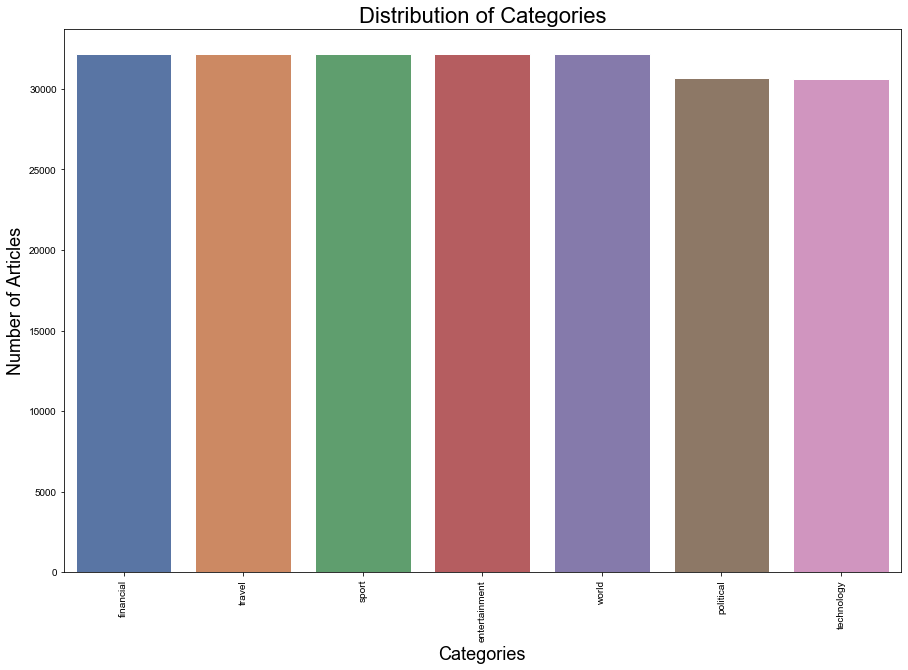

In [85]:
categories_count = df_all_news_processed['Category'].value_counts()
EDA.display_distribution_matplot(categories_count
                        ,"Distribution of Categories"
                        ,"Categories"
                        ,"Number of Articles")

In [86]:
df_distribution = EDA.count_records_per_label(df_all_news_processed, "Num_Records")
EDA.display_distribution_donut(df_distribution, 'Num_Records', 'Category', 'Dataset distribution after balancing with undersampling method (hover)')

In [87]:
#checkpoint:
#df_all_news_processed.reset_index(drop=True, inplace=True)
df_all_news_processed.to_pickle('data/original_data/pickles/df_all_news_processed_post_dataset_distribution')
#df_all_news_processed = pd.read_pickle(r'data/original_data/pickles/df_all_news_processed_post_dataset_distribution')
pd.options.display.max_colwidth = 500
df_all_news_processed.head(3)

,Title,Text,Category,Text_TotalWords
0,Tracy Morgan performs first stand-up show since accident,tracy morgan performs first stand-up show since accident tracy morgan coming back bang post facebook tracy morgan performs first stand-up show since accident tracy morgan coming back bang check story http 1rew1aj cancel send link sent email address posted link posted facebook feed join conver find facebook commenting please read conver guidelines faqs tracy morgan performs first stand-up show since accident today actor tracy morgan arrives 67th annual primetime emmy awards governors ball ang...,entertainment,186
1,President Barack Obama interviews author Marilynne Robinson,information president barack obama interviews author ilynne robinson file file photo president barack obama speaks congressional hispanic caucus institute chci 38th anniversary awards gala washington hillary rodham clinton private email york interview president barack obama asking questions discussion held last iowa posted new york review books obama asked pulitzer prize-winning author ilynne robinson faith democracy education writing obama explained robinson anxious unscripted discussion so...,entertainment,148
2,"I will perform at night clubs, shows β€“ Pastor Ofori Amponsah",source ghana hitz euphemia akpalu date time pm ofori amponsah highlife-musician-turned-pastor ofori amponsah says perform nightclubs even alcoholic company-sponsored events contracted people actually know secret want reveal told added that cannot judge laws forbid sale alcohol perform brand ambassador alcoholic beverages said promoting single alewa features sarkodie officially announced return highlife music interview hitz showbiz fylla amanda jissih ofori amponsah went hibernation releasing...,entertainment,181


### Buzzwords

Process completed.
Time taken: 5mins 6secs


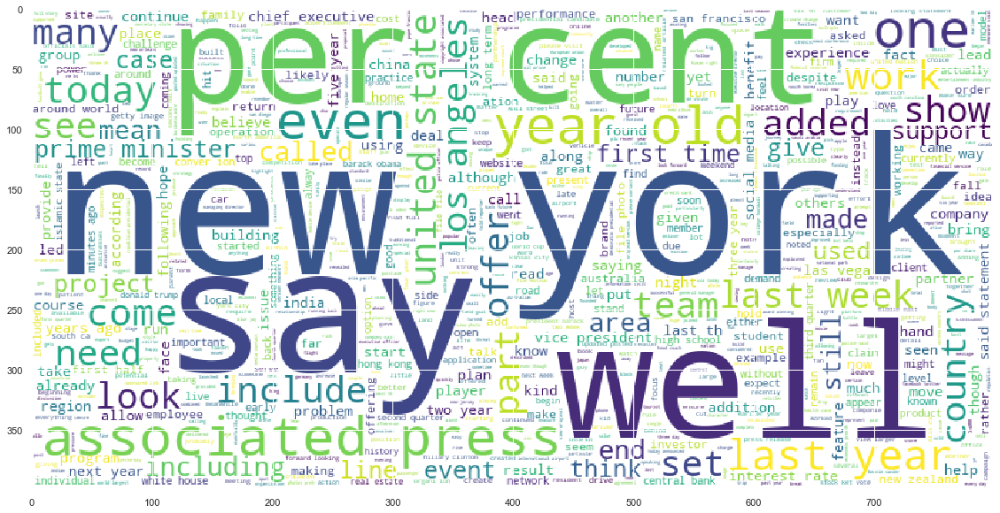

In [90]:
########### Values to configure ###########
 # Values: 'per_class' for each class seperately OR 'all_classes' for one buzzword image
type_of_buzzwords = 'all_classes'

# Values: True or False. Save the images at visuals folder
save_files = True 
###########################################

t1 = time.time()
if(type_of_buzzwords == 'per_class'):
    for cat in df_all_news_processed.Category.unique():
        temp = df_all_news_processed.loc[df_all_news_processed['Category'] == cat]
        EDA.display_buzzwords(list(temp['Text'].values), cat, type_of_buzzwords, save_files)
else:
    EDA.display_buzzwords(list(df_all_news_processed['Text'].values), None, type_of_buzzwords, save_files)

EDA.process_time(round(time.time()-t1))